In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, r2_score, mean_squared_error
import matplotlib.pyplot as plt
from sklearn import tree
import seaborn as sns
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 1000
sns.set_theme(style='darkgrid', palette='rainbow')
import warnings
warnings.filterwarnings('ignore')

In [2]:
data= pd.read_excel(r"C:\ExcelR\DS\Assignment\Random Forest\Random Forest\glass.xlsx",sheet_name = 1)

In [3]:
data

,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
0,1.52101,13.64,4.49,1.10,71.78,0.06,8.75,0.00,0.0,1
1,1.51761,13.89,3.60,1.36,72.73,0.48,7.83,0.00,0.0,1
2,1.51618,13.53,3.55,1.54,72.99,0.39,7.78,0.00,0.0,1
3,1.51766,13.21,3.69,1.29,72.61,0.57,8.22,0.00,0.0,1
4,1.51742,13.27,3.62,1.24,73.08,0.55,8.07,0.00,0.0,1
...,...,...,...,...,...,...,...,...,...,...
209,1.51623,14.14,0.00,2.88,72.61,0.08,9.18,1.06,0.0,7
210,1.51685,14.92,0.00,1.99,73.06,0.00,8.40,1.59,0.0,7
211,1.52065,14.36,0.00,2.02,73.42,0.00,8.44,1.64,0.0,7
212,1.51651,14.38,0.00,1.94,73.61,0.00,8.48,1.57,0.0,7


In [4]:
df= pd.DataFrame(data)

In [5]:
df

,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
0,1.52101,13.64,4.49,1.10,71.78,0.06,8.75,0.00,0.0,1
1,1.51761,13.89,3.60,1.36,72.73,0.48,7.83,0.00,0.0,1
2,1.51618,13.53,3.55,1.54,72.99,0.39,7.78,0.00,0.0,1
3,1.51766,13.21,3.69,1.29,72.61,0.57,8.22,0.00,0.0,1
4,1.51742,13.27,3.62,1.24,73.08,0.55,8.07,0.00,0.0,1
...,...,...,...,...,...,...,...,...,...,...
209,1.51623,14.14,0.00,2.88,72.61,0.08,9.18,1.06,0.0,7
210,1.51685,14.92,0.00,1.99,73.06,0.00,8.40,1.59,0.0,7
211,1.52065,14.36,0.00,2.02,73.42,0.00,8.44,1.64,0.0,7
212,1.51651,14.38,0.00,1.94,73.61,0.00,8.48,1.57,0.0,7


# EDA

In [6]:
df.isna().sum()

RI      0
Na      0
Mg      0
Al      0
Si      0
K       0
Ca      0
Ba      0
Fe      0
Type    0
dtype: int64

In [7]:
df.duplicated().sum()

1

In [8]:
df=df.drop_duplicates()

In [9]:
df.duplicated().sum()

0

# Data Visualization:


In [10]:
 #histograms, box plots, or pair plots

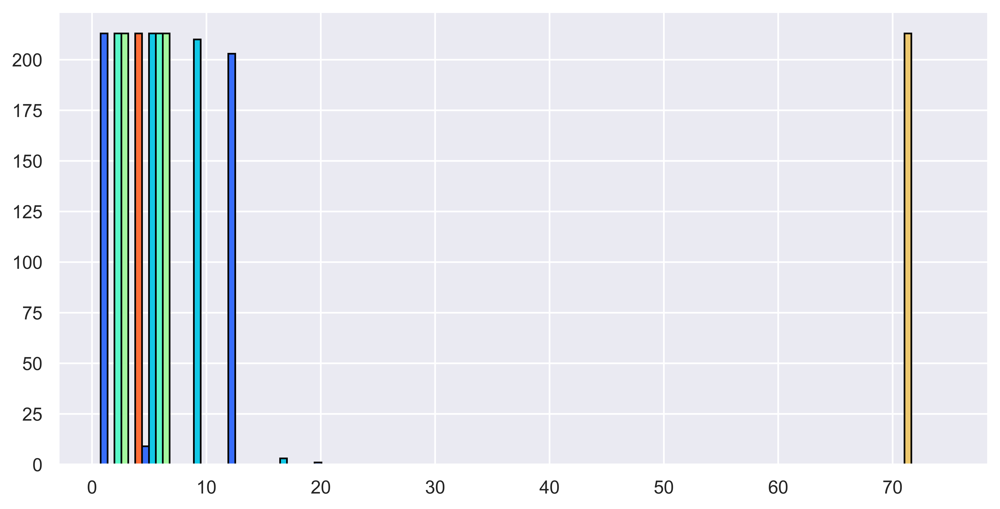

In [11]:
#histogram
plt.hist(df,edgecolor='black')
plt.show()

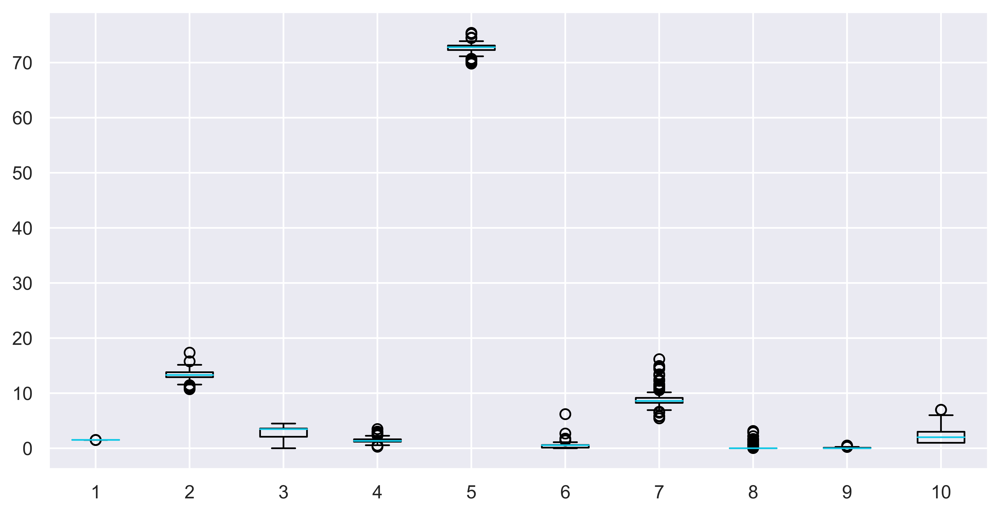

In [12]:
#boxplot
plt.boxplot(df)
plt.show()

In [13]:
sns.pairplot(df,hue='Type')
plt.show()

In [14]:
def outlier_detection(data, columns):
    
    for col in columns:
        q1 = data[col].quantile(0.25)
        q3 = data[col].quantile(0.75)
        iqr = q3-q1
    
        lower = q1-(1.5*iqr)
        upper = q3+(1.5*iqr)
        
        df[col] = np.where(df[col] > upper, upper, np.where(df[col] < lower, lower,df[col]))

In [15]:
outlier_detection(df,df.columns)

# Data Preprocessing

In [43]:
x = df.iloc[:,:-1]
y = df['Type']

In [44]:
scaler = StandardScaler()


In [45]:
x_scaled = scaler.fit_transform(x)

In [46]:
x_scaled

array([[ 1.21609303,  0.3226798 ,  1.25723832, ..., -0.04441938,
         0.        , -0.62110164],
       [-0.22720718,  0.6605561 ,  0.63931074, ..., -1.11573287,
         0.        , -0.62110164],
       [-0.83424227,  0.17401423,  0.6045957 , ..., -1.17395642,
         0.        , -0.62110164],
       ...,
       [ 1.06327301,  1.29576355, -1.86017161, ..., -0.40540545,
         0.        , -0.62110164],
       [-0.69415725,  1.32279365, -1.86017161, ..., -0.3588266 ,
         0.        , -0.62110164],
       [-0.43945721,  1.12006787, -1.86017161, ..., -0.19580063,
         0.        , -0.62110164]])

In [47]:
y

0      1.0
1      1.0
2      1.0
3      1.0
4      1.0
      ... 
209    6.0
210    6.0
211    6.0
212    6.0
213    6.0
Name: Type, Length: 213, dtype: float64

# Random Forest Model Implementation

In [48]:
xtrain,xtest,ytrain,ytest = train_test_split(x_scaled,y,train_size=0.8,random_state=42)

In [49]:
xtrain

array([[-0.94461229, -0.73149426,  0.58376668, ..., -0.9527069 ,
         0.        , -0.62110164],
       [ 1.6830431 ,  1.06600766,  0.76428485, ...,  0.40972438,
         0.        ,  2.30318328],
       [ 2.10117566, -2.52223866, -1.86017161, ...,  2.01087225,
         0.        , -0.62110164],
       ...,
       [-0.95310229, -0.21792228,  0.45879257, ..., -0.66158911,
         0.        , -0.62110164],
       [-2.18839747,  1.34982376, -0.65208848, ..., -1.39520595,
         0.        , -0.62110164],
       [ 2.10117566,  0.53892063,  0.32687544, ...,  2.01087225,
         0.        , -0.62110164]])

In [ ]:
xtest

In [50]:
ytrain

80     2.0
162    3.0
110    2.0
128    2.0
96     2.0
      ... 
107    2.0
14     1.0
93     2.0
180    6.0
103    2.0
Name: Type, Length: 170, dtype: float64

In [51]:
ytest

9      1.0
198    6.0
67     1.0
192    6.0
118    2.0
112    2.0
15     1.0
87     2.0
76     2.0
145    2.0
183    6.0
171    5.0
142    2.0
74     2.0
179    6.0
168    5.0
191    6.0
18     1.0
46     1.0
185    6.0
99     2.0
209    6.0
211    6.0
196    6.0
149    3.0
105    2.0
30     1.0
25     1.0
176    6.0
16     1.0
56     1.0
139    2.0
159    3.0
94     2.0
70     2.0
203    6.0
172    5.0
153    3.0
98     2.0
85     2.0
102    2.0
201    6.0
61     1.0
Name: Type, dtype: float64

In [52]:
rf = RandomForestRegressor()
rf.fit(xtrain,ytrain)
ypred = rf.predict(xtest)
ypred

array([1.07, 5.96, 1.22, 5.88, 1.47, 2.22, 1.  , 2.04, 2.04, 1.78, 3.87,
       4.88, 1.26, 1.97, 5.8 , 5.07, 5.88, 1.65, 1.49, 3.41, 1.5 , 5.92,
       5.7 , 5.73, 2.21, 3.42, 1.08, 1.07, 5.31, 1.4 , 1.5 , 1.9 , 2.26,
       2.05, 2.05, 6.  , 4.88, 2.45, 2.26, 1.98, 1.32, 4.39, 1.15])

In [53]:
r2_score(ytest,ypred)

0.8794337747458534

In [54]:
print('R2 value :', r2_score(ytest, ypred))

R2 value : 0.8794337747458534


In [55]:
mean_squared_error(ytest,ypred)

0.4874813953488373

In [56]:
np.sqrt(mean_squared_error(ytest, ypred))

0.6981986789939073

In [57]:
print(f"R2 values: {r2_score(ytest,ypred)}")
print(f"MSE: {mean_squared_error(ytest,ypred)}")
print(f"RMSE: {np.sqrt(mean_squared_error(ytest,ypred))}")

R2 values: 0.8794337747458534
MSE: 0.4874813953488373
RMSE: 0.6981986789939073


In [58]:
rf.estimators_

[DecisionTreeRegressor(max_features=1.0, random_state=1943033504),
 DecisionTreeRegressor(max_features=1.0, random_state=2093940020),
 DecisionTreeRegressor(max_features=1.0, random_state=1665158465),
 DecisionTreeRegressor(max_features=1.0, random_state=1780719787),
 DecisionTreeRegressor(max_features=1.0, random_state=1393603250),
 DecisionTreeRegressor(max_features=1.0, random_state=503985560),
 DecisionTreeRegressor(max_features=1.0, random_state=1568943887),
 DecisionTreeRegressor(max_features=1.0, random_state=1710265526),
 DecisionTreeRegressor(max_features=1.0, random_state=975663509),
 DecisionTreeRegressor(max_features=1.0, random_state=1416348770),
 DecisionTreeRegressor(max_features=1.0, random_state=1291443180),
 DecisionTreeRegressor(max_features=1.0, random_state=834567199),
 DecisionTreeRegressor(max_features=1.0, random_state=67027025),
 DecisionTreeRegressor(max_features=1.0, random_state=1747498112),
 DecisionTreeRegressor(max_features=1.0, random_state=581118983),
 

In [59]:
len(rf.estimators_)

100

In [60]:
rf.estimators_[99]

DecisionTreeRegressor(max_features=1.0, random_state=1925578007)

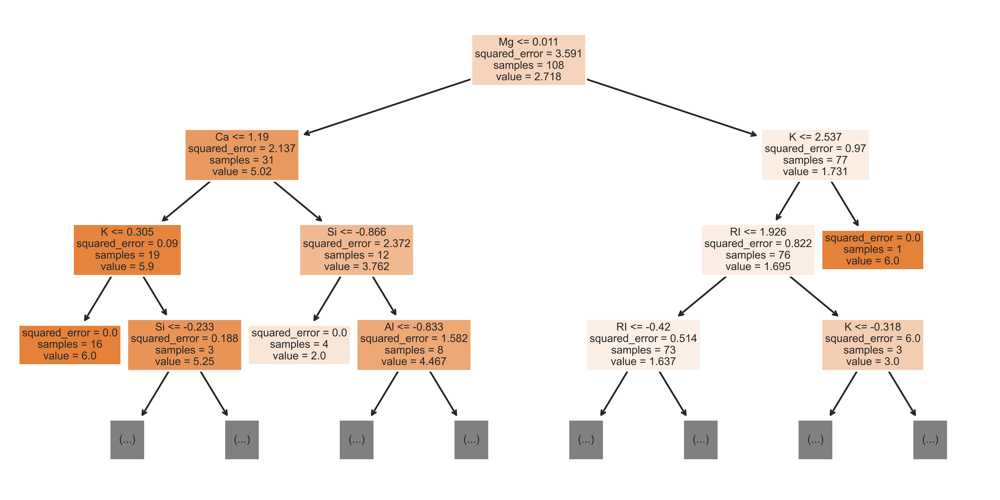

In [61]:
tree.plot_tree(rf.estimators_[85], feature_names=x.columns,
              filled=True, max_depth=3)
plt.show()

# Bagging and Boosting Methods

In [62]:
from sklearn.ensemble import BaggingClassifier

In [63]:
# Initialize the Bagging Classifier with Random Forest
bagging_model = BaggingClassifier(base_estimator=RandomForestClassifier(), n_estimators=100, random_state=42)


In [64]:
# Train the model
bagging_model.fit(xtrain, ytrain)


BaggingClassifier(base_estimator=RandomForestClassifier(), n_estimators=100,
                  random_state=42)

In [65]:
# Predictions on the test set
y_pred_bagging = bagging_model.predict(xtest)

In [66]:
# Evaluate the model
print(f'Bagging Accuracy: {accuracy_score(ytest, y_pred_bagging)}')
print(f'Bagging Classification Report:\n{classification_report(ytest, y_pred_bagging)}')


Bagging Accuracy: 0.8604651162790697
Bagging Classification Report:
              precision    recall  f1-score   support

         1.0       0.77      1.00      0.87        10
         2.0       0.86      0.80      0.83        15
         3.0       1.00      0.67      0.80         3
         5.0       0.75      1.00      0.86         3
         6.0       1.00      0.83      0.91        12

    accuracy                           0.86        43
   macro avg       0.88      0.86      0.85        43
weighted avg       0.88      0.86      0.86        43



#### Explain Bagging and Boosting methods. How is it different from each other.


Bagging  is an ensemble learning technique used to reduce the variance of a model by combining the predictions of multiple models (often of the same type) trained on different subsets of the training data.
It helps make models more robust and less prone to overfitting.

Boosting is an ensemble learning technique that focuses on improving the accuracy of a model by 
training a sequence of weak learners (usually decision trees) in such a way that each subsequent model 
tries to correct the mistakes of the previous one.
The main idea is to combine several weak models to create a strong model that performs better.